John Park (UBID: 50285417)

MTH 448

May 9, 2023

# Analyzing Marathon Results

## Introduction

This project delves into an application of data science to marathon results. The dataset to be focused contains race results of approximately 26,000 marathon runners. It has diverse variables, including but not limited to finish times, 5K times, and runner's age and gender. The ultimate goal is to extract meaningful insights and patterns within marathon running data by applying diverse statistical and machine learning methods.  

In order of investigation, the objectives are using Bayes' theorem and kernel density estimates (KDE) to predict runner gender based on finish times, comparing these predictions with results from k-nearest neighbors (k-NN), and applying linear regression to predict finish times based on 5K times and other variables. For the analysis, libraries such as Scipy for KDE, Sklearn for k-NN and linear regression, and data handling libraries such as Pandas and Numpy will be utilized.

By the end of this project, it is expected to have not only gained valuable insights into marathon running patterns but also demonstrated the power and utility of statistical and machine learning methods in analyzing and interpreting real-world data.

#### Importing Libraries

Before diving into the main investigation, the essential libraries are imported.

In [314]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from scipy.stats import gaussian_kde
%pylab inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


## Part 1. Predict Gender with Bayes Theorem Using Finish Times

The first part is investigating the application of kernel density estimates (KDE) and Bayes' theorem to predict runner gender based on finish times. KDE will provide a smooth approximation of the underlying distribution of finish times for each gender. Then, applying Bayes' theorem will compute the conditional probability of a runner being female given their finish time. This will allow to make gender predictions based on finish times and evaluate the accuracy.

In [328]:
# Read the csv data
marathonData = pd.read_csv("marathon_results.csv", index_col=0)

In [329]:
# Since the csv data is written in Str, new columns having time in float are created
marathonData['5K_minutes'] = pd.to_timedelta(marathonData['5K']).dt.total_seconds()/60
marathonData['10K_minutes'] = pd.to_timedelta(marathonData['10K']).dt.total_seconds()/60
marathonData['15K_minutes'] = pd.to_timedelta(marathonData['15K']).dt.total_seconds()/60
marathonData['20K_minutes'] = pd.to_timedelta(marathonData['20K']).dt.total_seconds()/60
marathonData['Half_minutes'] = pd.to_timedelta(marathonData['Half']).dt.total_seconds()/60
marathonData['25K_minutes'] = pd.to_timedelta(marathonData['25K']).dt.total_seconds()/60
marathonData['30K_minutes'] = pd.to_timedelta(marathonData['30K']).dt.total_seconds()/60
marathonData['35K_minutes'] = pd.to_timedelta(marathonData['35K']).dt.total_seconds()/60
marathonData['40K_minutes'] = pd.to_timedelta(marathonData['40K']).dt.total_seconds()/60
marathonData['tot_minutes'] = pd.to_timedelta(marathonData['Finish']).dt.total_seconds()/60
# Change Age as a new column
marathonData.reset_index(level=0, inplace=True)
# Print out part of csv file
marathonData.head()

,Age,M/F,Country,5K,10K,15K,20K,Half,25K,30K,...,5K_minutes,10K_minutes,15K_minutes,20K_minutes,Half_minutes,25K_minutes,30K_minutes,35K_minutes,40K_minutes,tot_minutes
0,25,M,ETH,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,14.716667,29.716667,44.950000,60.483333,64.033333,76.116667,92.000000,107.983333,122.650000,129.283333
1,30,M,ETH,00:14:43,00:29:43,00:44:58,01:00:28,01:04:01,01:16:07,01:31:59,...,14.716667,29.716667,44.966667,60.466667,64.016667,76.116667,91.983333,107.983333,122.700000,129.800000
2,29,M,KEN,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,14.716667,29.716667,44.950000,60.483333,64.033333,76.116667,92.000000,107.983333,123.016667,130.366667
3,28,M,KEN,00:14:43,00:29:44,00:45:01,01:00:29,01:04:02,01:16:07,01:32:00,...,14.716667,29.733333,45.016667,60.483333,64.033333,76.116667,92.000000,108.050000,123.783333,130.783333
4,32,M,KEN,00:14:43,00:29:44,00:44:58,01:00:28,01:04:01,01:16:07,01:32:00,...,14.716667,29.733333,44.966667,60.466667,64.016667,76.116667,92.000000,107.983333,123.450000,130.816667


In [330]:
# Split the data into a training set and a test set
marathon_train, marathon_test = train_test_split(marathonData, test_size=0.1, random_state=42)
# Bring tot_minutes for Male and Female from training data
marathon_male_train_1D = marathon_train[marathon_train['M/F'] == 'M']['tot_minutes']
marathon_female_train_1D = marathon_train[marathon_train['M/F'] == 'F']['tot_minutes']
# Compute KDE using training data
kde_male_1D = gaussian_kde(marathon_male_train_1D)
kde_female_1D = gaussian_kde(marathon_female_train_1D)
# Compute priors using training data
prior_male_1D = len(marathon_male_train_1D) / len(marathon_train)
prior_female_1D = len(marathon_female_train_1D) / len(marathon_train)

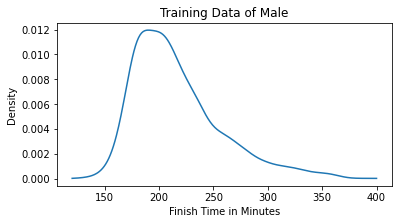

In [343]:
male_kde_1D = gaussian_kde(marathon_male_train_1D,bw_method=.2)
plt.figure(figsize=(6, 3))
x = np.linspace(120,400,400)
# Create the plot for KDE
plt.plot(x, male_kde_1D(x));
# naming of x-axis and y-axis
plt.xlabel("Finish Time in Minutes")
plt.ylabel("Density")
# naming the title of the plot
plt.title("Training Data of Male")
plt.show()

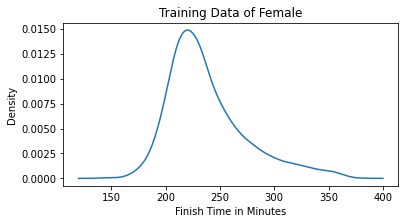

In [344]:
female_kde_2D = gaussian_kde(marathon_female_train_1D,bw_method=.2)
plt.figure(figsize=(6, 3))
x = np.linspace(120,400,400)
# Create the plot for KDE
plt.plot(x, female_kde_2D(x));
# naming of x-axis and y-axis
plt.xlabel("Finish Time in Minutes")
plt.ylabel("Density")
# naming the title of the plot
plt.title("Training Data of Female")
plt.show()

The Bandwith method: "bw_method" determines the smoothness of the density estimate. A small bandwidth value can make the KDE overfit the data, resulting in a density estimate that is highly jagged and captures the noise in the data. On the other hand, a large bandwidth can cause the KDE to underfit the data, producing a density estimate that is excessively smooth and potentially oversimplifies the underlying distribution. Hence, applying various values of bandwidth displays the changes of the graphs above.

In [333]:
# Define the predict_MF function
def predict_MF_1D(finish_time):
    # Compute likelihoods
    likelihood_male_1D = kde_male_1D(finish_time)
    likelihood_female_1D = kde_female_1D(finish_time)
    # Compute posterior probabilities
    posterior_male_1D = likelihood_male_1D * prior_male_1D
    posterior_female_1D = likelihood_female_1D * prior_female_1D
    # Return the gender with the highest posterior probability
    return 'M' if posterior_male_1D > posterior_female_1D else 'F'

In [334]:
# Make predictions for finish times in the test data
predictions_1D = marathon_test['tot_minutes'].apply(predict_MF_1D)
# Check accuracy of the predictions
pred_results_1D = (predictions_1D == marathon_test['M/F'])
accuracy_1D = pred_results_1D.sum() / len(pred_results_1D)
accuracy_1D

0.6570342205323194

Since the choice of bandwidth have a significant impact on the accuracy, different values are applied, and the $0.2$ value of bw_method gives the highest accuracy for the data.

## Part 2. Predict Gender with Bayes Theorem Using Finish Times and Ages

As an extension of the first part, the second part extends the analysis to two dimensions: finish times and ages of runners. The aim is to examine whether incorporating the age factor into our KDE and Bayes' theorem framework improves the accuracy of gender predictions. This study will provide a richer understanding of the interplay between age, finish time, and gender in marathon results.

In [357]:
import plotly.graph_objects as go

In [358]:
# Bring tot_minutes and age for Male and Female from training data
marathon_male_train_2D = marathon_train[marathon_train['M/F'] == 'M'][['Age', 'tot_minutes']]
marathon_female_train_2D = marathon_train[marathon_train['M/F'] == 'F'][['Age', 'tot_minutes']]
# Compute KDE using training data
kde_male_2D = gaussian_kde(marathon_male_train_2D.T)
kde_female_2D = gaussian_kde(marathon_female_train_2D.T)
# Compute priors using training data
prior_male_2D = len(marathon_male_train_2D) / len(marathon_train)
prior_female_2D = len(marathon_female_train_2D) / len(marathon_train)

The following two graphs represent the training data of male and female in 2-dimensional KDEs, respectively. 

In [360]:
x = np.linspace(-1,80,400)
y = np.linspace(-1,450,400)
X,Y = np.meshgrid(x, y)
Z = kde_male_2D([X.reshape(-1),Y.reshape(-1)]).reshape(X.shape)
# Create the plot for KDE
fig = go.Figure(go.Surface(x=X,y=Y,z=Z))
# naming the title of the plot and labeling x, y, z-axis
fig.update_layout(
    title='3D Graph of Male 2D KDEs', 
    autosize=False,
    width=1000, 
    height=500,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title='Age',
        yaxis_title='Total Time',
        zaxis_title='Density',
    ),
)
fig.show()

In [361]:
x = np.linspace(-1,80,400)
y = np.linspace(-1,450,400)
X,Y = np.meshgrid(x,y)
Z = kde_female_2D([X.reshape(-1),Y.reshape(-1)]).reshape(X.shape)
# Create the plot for KDE
fig = go.Figure(go.Surface(x=X,y=Y,z=Z))
# naming the title of the plot and labeling x, y, z-axis
fig.update_layout(
    title='3D Graph of Female 2D KDEs', 
    autosize=False,
    width=1000, 
    height=500,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title='Age',
        yaxis_title='Total Time',
        zaxis_title='Density',
    ),
)
fig.show()

In [337]:
def predict_MF_2D(data):
    # Compute likelihoods
    likelihood_male_2D = kde_male_2D(data)
    likelihood_female_2D = kde_female_2D(data)
    # Compute posterior probabilities
    posterior_male_2D = likelihood_male_2D * prior_male_2D
    posterior_female_2D = likelihood_female_2D * prior_female_2D
    # Return the gender with the highest posterior probability
    return 'M' if posterior_male_2D > posterior_female_2D else 'F'

In [338]:
# Make predictions for finish times in the test data
predictions_2D = marathon_test[['Age', 'tot_minutes']].apply(predict_MF_2D, axis = 1)
# Check accuracy of the predictions
pred_results_2D = (predictions_2D == marathon_test['M/F'])
accuracy_2D = pred_results_2D.sum() / len(pred_results_2D)
accuracy_2D

0.7600760456273764

Incorporating the age into Part 1 produces approximately 10% higher accuracy.

## Part 3-1. Predict with k-NN Algorithm

In addition to the Bayes' theorem, k-NN algorithm is a type of learning algorithm used for classification and regression. This section involves a comparison of KDE-based gender predictions with results obtained from the k-nearest neighbors (k-NN) algorithm. This comparison will help to contrast the efficacy of a non-parametric density estimation method (KDE) with an instance-based learning method (k-NN) in predicting runner gender based on finish times and age.

In order to generate the most accurate results, the number of neighbors have been increased to 200.

### 3-1. Using Finish Times

In [84]:
from sklearn.neighbors import KNeighborsClassifier

In [385]:
# 1D data
# Preparing Data
marathon_train_1D_knn_X = marathon_train['tot_minutes'].values.reshape(-1,1)
marathon_train_1D_knn_y = marathon_train['M/F']
marathon_test_1D_knn_X = marathon_test['tot_minutes'].values.reshape(-1,1)
marathon_test_1D_knn_y = marathon_test['M/F']
# Initialize and Fit the kNN classifier
knn_1D = KNeighborsClassifier(n_neighbors = 200)
knn_1D.fit(marathon_train_1D_knn_X, marathon_train_1D_knn_y)

KNeighborsClassifier(n_neighbors=200)

In [386]:
# Calculation for the accuracy
predictions_1D = knn_1D.predict(marathon_test_1D_knn_X)
accuracy_1D = (marathon_test_1D_knn_y == predictions_1D).sum() / len(predictions_1D)
accuracy_1D

0.6532319391634981

### 3-2. Using Finish Times and Ages

In [387]:
# 2D data
# Preparing Data
marathon_train_2D_knn_X = marathon_train[['tot_minutes', 'Age']]
marathon_train_2D_knn_y = marathon_train['M/F']
marathon_test_2D_knn_X = marathon_test[['tot_minutes', 'Age']]
marathon_test_2D_knn_y = marathon_test['M/F']
# Initialize and Fit the kNN classifier
knn_2D = KNeighborsClassifier(n_neighbors = 200)
knn_2D.fit(marathon_train_2D_knn_X, marathon_train_2D_knn_y)

KNeighborsClassifier(n_neighbors=200)

In [388]:
# Calculation for the accuracy
predictions_2D_knn = knn_2D.predict(marathon_test_2D_knn_X)
accuracy_2D_knn = (marathon_test_2D_knn_y == predictions_2D_knn).sum() / len(predictions_2D_knn)
accuracy_2D_knn

0.7570342205323194

Comparing the results from the Bayes' theorem and k-NN algorithm, the accuracies do not make large differences, which means that better techniques are required for distinguishing the gender.

## Part 4. Predict Finish Times with Linear Regression

In the fourth part of the project, the focus will be shifted to predicting finish times of runners. This section will begin by using linear regression to model the relationship between finish times and 5K times. Then, by incorporating additional variables, such as the runner's age and gender, it will be observed if these factors improve our model's predictive power. This part will explore the linear dependencies in the dataset and test its significance in predicting runner performance.

### 4-1. Using 5K Times

In [255]:
from sklearn.linear_model import LinearRegression
import seaborn as sns
reg = LinearRegression()

In [391]:
# Preparing Data
# For 5K_minutes, reshape it because it is 1D array
marathon_train_5k = marathon_train['5K_minutes'].values.reshape(-1, 1)
marathon_train_5k_finish = marathon_train['tot_minutes']
marathon_test_5k = marathon_test['5K_minutes'].values.reshape(-1, 1)
marathon_test_5k_finish = marathon_test['tot_minutes']
# Trains the model
reg.fit(marathon_train_5k, marathon_train_5k_finish)

LinearRegression()

In [392]:
# Let it predict for test data
predictions_5k = reg.predict(marathon_test_5k)

In [258]:
# Coefficients for the predictors in the regression model
reg.coef_

array([9.15650111])

In [393]:
# Intercept of the linear regression line
reg.intercept_

-7.713555822786276

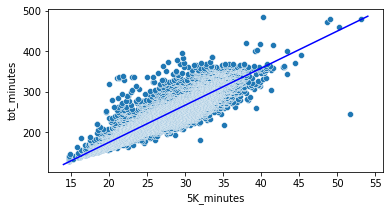

In [260]:
plt.figure(figsize=(6, 3))
sns.scatterplot(data=marathonData, x='5K_minutes', y='tot_minutes', marker='o')
x = np.arange(14, 55)
plt.plot(x, reg.coef_[0]*x + reg.intercept_, c='b');

In [395]:
# Make a new column called "Regression" for pedictions
marathonData['Regression'] = reg.predict(marathonData['5K_minutes'].values.reshape(-1,1))
# Regression Error for difference between real value and predictions
marathonData['Regression_error'] = marathonData['Regression'] - marathonData['tot_minutes']
marathonData

,Age,M/F,Country,5K,10K,15K,20K,Half,25K,30K,...,15K_minutes,20K_minutes,Half_minutes,25K_minutes,30K_minutes,35K_minutes,40K_minutes,tot_minutes,Regression,Regression_error
0,25,M,ETH,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,44.950000,60.483333,64.033333,76.116667,92.000000,107.983333,122.650000,129.283333,127.039619,-2.243714
1,30,M,ETH,00:14:43,00:29:43,00:44:58,01:00:28,01:04:01,01:16:07,01:31:59,...,44.966667,60.466667,64.016667,76.116667,91.983333,107.983333,122.700000,129.800000,127.039619,-2.760381
2,29,M,KEN,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,44.950000,60.483333,64.033333,76.116667,92.000000,107.983333,123.016667,130.366667,127.039619,-3.327048
3,28,M,KEN,00:14:43,00:29:44,00:45:01,01:00:29,01:04:02,01:16:07,01:32:00,...,45.016667,60.483333,64.033333,76.116667,92.000000,108.050000,123.783333,130.783333,127.039619,-3.743714
4,32,M,KEN,00:14:43,00:29:44,00:44:58,01:00:28,01:04:01,01:16:07,01:32:00,...,44.966667,60.466667,64.016667,76.116667,92.000000,107.983333,123.450000,130.816667,127.039619,-3.777048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26293,64,F,USA,00:50:15,01:43:31,02:36:53,03:32:26,03:43:46,04:25:53,05:19:44,...,156.883333,212.433333,223.766667,265.883333,319.733333,377.316667,433.566667,458.933333,452.400625,-6.532708
26294,61,F,USA,00:48:36,01:39:39,02:39:13,03:35:58,03:47:55,04:32:44,05:31:58,...,159.216667,215.966667,227.916667,272.733333,331.966667,388.933333,446.316667,471.500000,437.292398,-34.207602
26295,66,F,USA,00:53:03,01:47:16,02:41:45,03:37:07,03:48:21,04:33:51,05:38:56,...,161.750000,217.116667,228.350000,273.850000,338.933333,398.850000,456.300000,479.550000,478.038828,-1.511172
26296,53,M,USA,00:49:04,01:40:12,02:33:31,03:31:41,03:43:35,04:29:20,05:31:11,...,153.516667,211.683333,223.583333,269.333333,331.183333,393.583333,455.633333,480.616667,441.565432,-39.051234


In [396]:
# Find the mean of regression error
# Smaller value refers to Higher Accuracy
marathonData['Regression_error'].mean()

-0.022882930642882063

In [263]:
np.abs(marathonData['Regression_error']).describe()

count    26298.000000
mean        10.970552
std         11.574615
min          0.000202
25%          3.720347
50%          7.730516
75%         13.811412
max        218.989002
Name: Regression_error, dtype: float64

### 4-2. Using 5K Times, Ages, and Sex

In [264]:
from sklearn.preprocessing import OneHotEncoder

In [265]:
reg2 = LinearRegression()

In [399]:
# Preparing Data
marathon_train_lin = marathon_train[['Age', '5K_minutes']]
marathon_train_lin_finish = marathon_train_5k_finish
marathon_test_lin = marathon_test[['Age', '5K_minutes']]
marathon_test_lin_finish = marathon_test_5k_finish

In [398]:
# One-hot encode the 'M/F' column
encoder = OneHotEncoder(drop = 'first')
marathon_train_mf_encoded = encoder.fit_transform(marathon_train['M/F'].values.reshape(-1, 1)).toarray()
marathon_test_mf_encoded = encoder.transform(marathon_test['M/F'].values.reshape(-1, 1)).toarray()
# Concatenate the one-hot encoded gender with the other features
marathon_train_lin_encoded = np.column_stack((marathon_train_lin, marathon_train_mf_encoded))
marathon_test_lin_encoded = np.column_stack((marathon_test_lin, marathon_test_mf_encoded))
# Trains the model
reg2.fit(marathon_train_lin_encoded, marathon_train_5k_finish)

LinearRegression()

In [268]:
# Let it predict for test data
predictions_lin = reg2.predict(marathon_test_lin_encoded)

In [269]:
# Coefficients for the predictors in the regression model
reg2.coef_

array([ 0.16989103,  9.0588832 , -0.06118374])

In [270]:
# Intercept of the linear regression line
reg2.intercept_

-12.355344853315046

In [271]:
# Concatenate two numpy arrays
encoded_data = np.concatenate((marathon_train_lin_encoded, marathon_test_lin_encoded), axis=0)

In [272]:
# Make a new column called "Regression_2" for pedictions
marathonData['Regression_2'] = reg2.predict(encoded_data)
# Regression 2 Error for difference between real value and predictions
marathonData['Regression_2_error'] = marathonData['Regression_2'] - marathonData['tot_minutes']
marathonData

,Age,M/F,Country,5K,10K,15K,20K,Half,25K,30K,...,20K_minutes,Half_minutes,25K_minutes,30K_minutes,35K_minutes,40K_minutes,Regression,Regression_error,Regression_2,Regression_2_error
0,25,M,ETH,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,60.483333,64.033333,76.116667,92.000000,107.983333,122.650000,127.039619,-2.243714,205.168334,75.885000
1,30,M,ETH,00:14:43,00:29:43,00:44:58,01:00:28,01:04:01,01:16:07,01:31:59,...,60.466667,64.016667,76.116667,91.983333,107.983333,122.700000,127.039619,-2.760381,190.013170,60.213170
2,29,M,KEN,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,60.483333,64.033333,76.116667,92.000000,107.983333,123.016667,127.039619,-3.327048,254.562907,124.196241
3,28,M,KEN,00:14:43,00:29:44,00:45:01,01:00:29,01:04:02,01:16:07,01:32:00,...,60.483333,64.033333,76.116667,92.000000,108.050000,123.783333,127.039619,-3.743714,196.788423,66.005090
4,32,M,KEN,00:14:43,00:29:44,00:44:58,01:00:28,01:04:01,01:16:07,01:32:00,...,60.466667,64.016667,76.116667,92.000000,107.983333,123.450000,127.039619,-3.777048,186.054586,55.237919
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26293,64,F,USA,00:50:15,01:43:31,02:36:53,03:32:26,03:43:46,04:25:53,05:19:44,...,212.433333,223.766667,265.883333,319.733333,377.316667,433.566667,452.400625,-6.532708,208.829115,-250.104218
26294,61,F,USA,00:48:36,01:39:39,02:39:13,03:35:58,03:47:55,04:32:44,05:31:58,...,215.966667,227.916667,272.733333,331.966667,388.933333,446.316667,437.292398,-34.207602,237.312914,-234.187086
26295,66,F,USA,00:53:03,01:47:16,02:41:45,03:37:07,03:48:21,04:33:51,05:38:56,...,217.116667,228.350000,273.850000,338.933333,398.850000,456.300000,478.038828,-1.511172,215.778418,-263.771582
26296,53,M,USA,00:49:04,01:40:12,02:33:31,03:31:41,03:43:35,04:29:20,05:31:11,...,211.683333,223.583333,269.333333,331.183333,393.583333,455.633333,441.565432,-39.051234,183.615223,-297.001443


In [273]:
# Find the mean of regression error
# Smaller value refers to Higher Accuracy
marathonData['Regression_2_error'].mean()

-0.029820205480961023

In [274]:
np.abs(marathonData['Regression_2_error']).describe()

count    26298.000000
mean        42.685612
std         34.383321
min          0.000725
25%         15.813723
50%         34.085489
75%         61.211871
max        297.001443
Name: Regression_2_error, dtype: float64

## Part 5. Extension of Linear Regression

Finally, the fifth part of our project will extend the fourth part to incorporating all the time split data and predicting finish times with linear regression. This further study will investigate how close the linear regression can prdict the finish times.

In [275]:
reg3 = LinearRegression()

In [307]:
# Preparing Data
marathon_train_lin_2 = marathon_train[['Age', '5K_minutes', '10K_minutes', '15K_minutes', 'Half_minutes', '25K_minutes', '30K_minutes', '35K_minutes', '40K_minutes']]
marathon_train_lin_2_finish = marathon_train_5k_finish
marathon_test_lin_2 = marathon_test[['Age', '5K_minutes', '10K_minutes', '15K_minutes', 'Half_minutes', '25K_minutes', '30K_minutes', '35K_minutes', '40K_minutes']]
marathon_test_lin_2_finish = marathon_test_5k_finish
# Trains the model
reg3.fit(marathon_train_lin_2, marathon_train_lin_2_finish)

LinearRegression()

In [308]:
# Let it predict for test data
predictions_lin_2 = reg3.predict(marathon_test_lin_2)

In [309]:
# Coefficients for the predictors in the regression model
reg3.coef_

array([ 0.01245221, -0.0673983 ,  0.0386644 , -0.04083582,  0.02270805,
       -0.01484698, -0.09248491, -0.1245554 ,  1.2374005 ])

In [310]:
# Intercept of the linear regression line
reg3.intercept_

1.059779567194937

In [400]:
# Make a new column called "Regression_3" for pedictions
marathonData['Regression_3'] = reg3.predict(marathonData[['Age', '5K_minutes', '10K_minutes', '15K_minutes', 'Half_minutes', '25K_minutes', '30K_minutes', '35K_minutes', '40K_minutes']])
# Regression 3 Error for difference between real value and predictions
marathonData['Regression_3_error'] = marathonData['Regression_3'] - marathonData['tot_minutes']
marathonData

,Age,M/F,Country,5K,10K,15K,20K,Half,25K,30K,...,Half_minutes,25K_minutes,30K_minutes,35K_minutes,40K_minutes,tot_minutes,Regression,Regression_error,Regression_3,Regression_3_error
0,25,M,ETH,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,64.033333,76.116667,92.000000,107.983333,122.650000,129.283333,127.039619,-2.243714,129.825236,0.541902
1,30,M,ETH,00:14:43,00:29:43,00:44:58,01:00:28,01:04:01,01:16:07,01:31:59,...,64.016667,76.116667,91.983333,107.983333,122.700000,129.800000,127.039619,-2.760381,129.949849,0.149849
2,29,M,KEN,00:14:43,00:29:43,00:44:57,01:00:29,01:04:02,01:16:07,01:32:00,...,64.033333,76.116667,92.000000,107.983333,123.016667,130.366667,127.039619,-3.327048,130.328758,-0.037909
3,28,M,KEN,00:14:43,00:29:44,00:45:01,01:00:29,01:04:02,01:16:07,01:32:00,...,64.033333,76.116667,92.000000,108.050000,123.783333,130.783333,127.039619,-3.743714,131.254598,0.471265
4,32,M,KEN,00:14:43,00:29:44,00:44:58,01:00:28,01:04:01,01:16:07,01:32:00,...,64.016667,76.116667,92.000000,107.983333,123.450000,130.816667,127.039619,-3.777048,130.901907,0.085240
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26293,64,F,USA,00:50:15,01:43:31,02:36:53,03:32:26,03:43:46,04:25:53,05:19:44,...,223.766667,265.883333,319.733333,377.316667,433.566667,458.933333,452.400625,-6.532708,457.127922,-1.805412
26294,61,F,USA,00:48:36,01:39:39,02:39:13,03:35:58,03:47:55,04:32:44,05:31:58,...,227.916667,272.733333,331.966667,388.933333,446.316667,471.500000,437.292398,-34.207602,470.148062,-1.351938
26295,66,F,USA,00:53:03,01:47:16,02:41:45,03:37:07,03:48:21,04:33:51,05:38:56,...,228.350000,273.850000,338.933333,398.850000,456.300000,479.550000,478.038828,-1.511172,480.568601,1.018601
26296,53,M,USA,00:49:04,01:40:12,02:33:31,03:31:41,03:43:35,04:29:20,05:31:11,...,223.583333,269.333333,331.183333,393.583333,455.633333,480.616667,441.565432,-39.051234,481.244812,0.628145


In [401]:
# Find the mean of regression error
# Smaller value refers to Higher Accuracy
marathonData['Regression_3_error'].mean()

-0.0008724537798537618

In [313]:
np.abs(marathonData['Regression_3_error']).describe()

count    26298.000000
mean         0.604297
std          0.840498
min          0.000006
25%          0.195422
50%          0.412595
75%          0.734638
max         22.411467
Name: Regression_3_error, dtype: float64

## Conclusion

Throughout this project, a range of statistical and machine learning techniques have been explored and applied to analyze marathon results. Kernel density estimation (KDE) and Bayes' theorem helped to predict gender based on finish times, and this approach is extended to incorporate the age of runners for a two-dimensional KDE. Then, the comparison between the accuracy from Bayes' Theorem and the results obtained from the k-nearest neighbors (k-NN) algorithm offers interesting insights into the efficacy of different predictive methodologies.

Then, as the project shifted the aim to finding finish times, it employed linear regression to model and predict these based on 5K times, runner's age, and gender. Then, further investigation was institued to predict how close linear regression predict by incorporating all variables related to time splits. These studies help to explore the linear dependencies in our dataset and evaluate their significances in predicting runner performance.

As with any data science project, the results obtained could be improved with more data or refined with more sophisticated modeling techniques. Nevertheless, the exploration has shown promising results and provides a solid foundation for any future work in this area.

## References

Conlen, B. M. (n.d.). Kernel Density Estimation. Redirect to... mathisonian.com. https://mathisonian.github.io/kde/ 

Layout. Plotly. (n.d.). https://plotly.com/python/reference/layout/ 

Nik. (2022, August 8). One-hot encoding in Scikit-learn with onehotencoder • datagy. datagy. https://datagy.io/sklearn-one-hot-encode/ 

Numpy.concatenate#. numpy.concatenate - NumPy v1.24 Manual. (n.d.). https://numpy.org/doc/stable/reference/generated/numpy.concatenate.html 